# APE
## Anatomical Positional Embeddings

In [91]:
import autorootcwd
import torch
import numpy as np
import nibabel as nib
from pathlib import Path
from src.utils.ape.model import APE
from sklearn.decomposition import PCA
import torch.nn.functional as F
import matplotlib.pyplot as plt
from tqdm import tqdm
import os
import matplotlib.animation as animation
from IPython.display import HTML
from sklearn.manifold import TSNE
import matplotlib.cm as cm
from mpl_toolkits.mplot3d import Axes3D

## Load dataset

In [3]:
def load_image(image_path: str) -> tuple[torch.Tensor, nib.Nifti1Image]:
    """Load NIfTI image and preprocess it."""
    # Load NIfTI image
    nifti_img = nib.load(image_path)
    image = nifti_img.get_fdata()
    
    # Convert to float32 and normalize (0-1 range)
    image = np.float32(image)
    image = (image - image.min()) / (image.max() - image.min())
    
    # Add batch and channel dimensions [B, C, H, W, D]
    image = torch.from_numpy(image)[None, None]
    
    return image, nifti_img

## Inference Model

In [71]:
def inference(
    model: APE,
    image: torch.Tensor,
    mask: torch.Tensor = None,
    device: str = 'cuda' if torch.cuda.is_available() else 'cpu'
) -> torch.Tensor:
    """calculate anatomical position embeddings using APE model."""
    model = model.to(device)
    model.eval()
    
    image = image.to(device)
    if mask is not None:
        mask = mask.to(device)

    _, _, H, W, D = image.shape
    
    with torch.no_grad():
        # calculate basic APE maps (shape: [B, 3, H, W, D])
        ape_maps = model(image, mask)

        # trilinear upsampling
        ape_maps_upsampled = F.interpolate(
            ape_maps, 
            size=(H, W, D),  # original size
            mode='trilinear',  # trilinear interpolation
            align_corners=False  # generally recommended
        )
        
        # convert to sin-cos embeddings (shape: [B, embed_dim, H, W, D])
        embeddings = model.to_sin_cos(ape_maps_upsampled)
    
    return ape_maps_upsampled, embeddings


## Visualize

#### Comparision original image with ape maps

In [12]:
def visualize_ape_maps(ape_maps: torch.Tensor) -> np.ndarray:
    """convert 3-channel APE maps to RGB visualization."""
    # [B, 3, H, W, D] -> [H, W, D, 3]
    ape_np = ape_maps.cpu().numpy()
    ape_np = np.squeeze(ape_np, axis=0)  # remove batch dimension
    ape_rgb = np.moveaxis(ape_np, 0, -1)  # move channel to last dimension
    
    # already in 0-1 range, so no additional normalization needed (Sigmoid passed)
    return ape_rgb

def plot_comparison_slices(image: np.ndarray, rgb_volume: np.ndarray):
    """visualize original image and APE maps."""
    # calculate mid slice index
    
    h, w, d = rgb_volume.shape[:3]
    h_orig, w_orig, d_orig = image.shape
    
    # mid slice - now same for both original and APE maps
    mid_h, mid_w, mid_d = h//2, w//2, d//2
    
    # original image mid slice (same as APE maps)
    mid_h_orig = mid_h
    mid_w_orig = mid_w
    mid_d_orig = mid_d

    fig, axes = plt.subplots(2, 3, figsize=(12, 8))
    fig.suptitle('Original Image vs Anatomical Position Embeddings', fontsize=14)

    # first row: original image
    # Axial view
    axes[0,0].imshow(image[mid_h_orig, :, :], cmap='gray')
    axes[0,0].set_title(f'Original - Axial (Slice {mid_h_orig}/{h_orig})')
    axes[0,0].axis('off')

    # Sagittal view
    axes[0,1].imshow(image[:, mid_w_orig, :], cmap='gray')
    axes[0,1].set_title(f'Original - Sagittal (Slice {mid_w_orig}/{w_orig})')
    axes[0,1].axis('off')

    # Coronal view
    axes[0,2].imshow(image[:, :, mid_d_orig], cmap='gray')
    axes[0,2].set_title(f'Original - Coronal (Slice {mid_d_orig}/{d_orig})')
    axes[0,2].axis('off')

    # second row: APE maps
    # Axial view
    axes[1,0].imshow(rgb_volume[mid_h, :, :])
    axes[1,0].set_title(f'APE Maps - Axial (Slice {mid_h}/{h})')
    axes[1,0].axis('off')

    # Sagittal view
    axes[1,1].imshow(rgb_volume[:, mid_w, :])
    axes[1,1].set_title(f'APE Maps - Sagittal (Slice {mid_w}/{w})')
    axes[1,1].axis('off')

    # Coronal view
    axes[1,2].imshow(rgb_volume[:, :, mid_d])
    axes[1,2].set_title(f'APE Maps - Coronal (Slice {mid_d}/{d})')
    axes[1,2].axis('off')

    plt.tight_layout()
    
    return fig

image.shape torch.Size([1, 1, 512, 512, 275])
ape_maps.shape torch.Size([1, 3, 512, 512, 275])
embeddings.shape torch.Size([1, 24, 512, 512, 275])
ape_maps tensor([[[[[0.0676, 0.0676, 0.0691,  ..., 0.0385, 0.0384, 0.0384],
           [0.0676, 0.0676, 0.0691,  ..., 0.0385, 0.0384, 0.0384],
           [0.0750, 0.0750, 0.0765,  ..., 0.0418, 0.0416, 0.0416],
           ...,
           [0.9301, 0.9301, 0.9294,  ..., 0.9888, 0.9888, 0.9888],
           [0.9332, 0.9332, 0.9325,  ..., 0.9893, 0.9894, 0.9894],
           [0.9332, 0.9332, 0.9325,  ..., 0.9893, 0.9894, 0.9894]],

          [[0.0676, 0.0676, 0.0691,  ..., 0.0385, 0.0384, 0.0384],
           [0.0676, 0.0676, 0.0691,  ..., 0.0385, 0.0384, 0.0384],
           [0.0750, 0.0750, 0.0765,  ..., 0.0418, 0.0416, 0.0416],
           ...,
           [0.9301, 0.9301, 0.9294,  ..., 0.9888, 0.9888, 0.9888],
           [0.9332, 0.9332, 0.9325,  ..., 0.9893, 0.9894, 0.9894],
           [0.9332, 0.9332, 0.9325,  ..., 0.9893, 0.9894, 0.9894]],

    

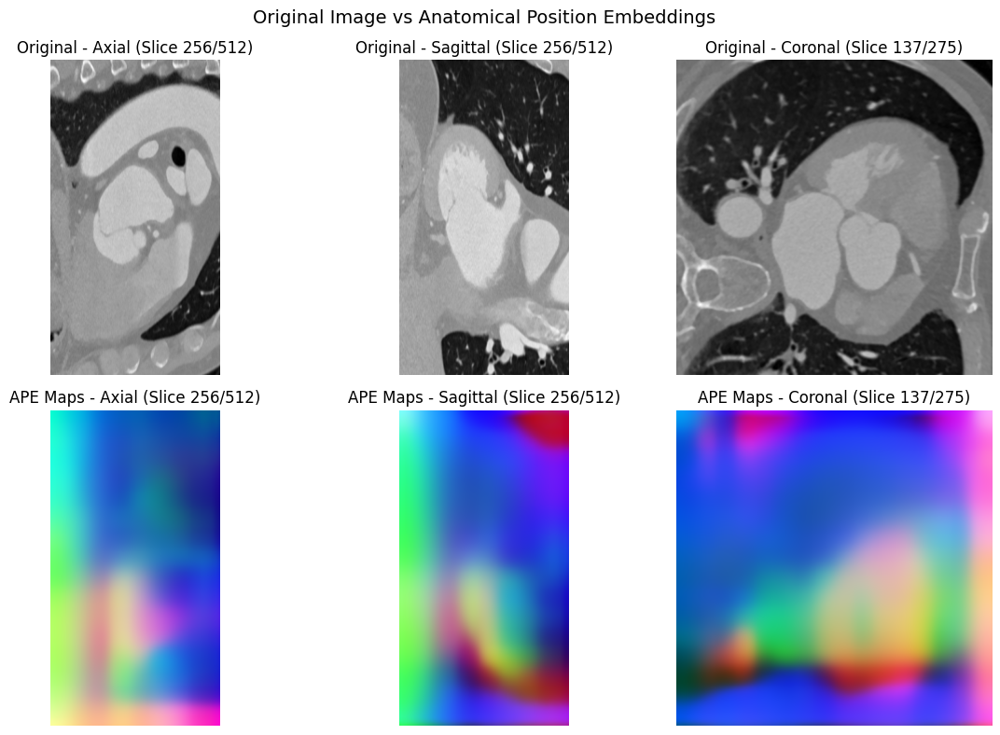

In [118]:
# load image and APE maps
model = APE(pretrained=True)

image_path = "data/imageCAS_heart/train/1/img.nii.gz" 
patient_id = Path(image_path).parent.name

image, nifti_img = load_image(image_path)
ape_maps, embeddings = inference(model, image)

print("image.shape", image.shape)
print("ape_maps.shape", ape_maps.shape)
print("embeddings.shape", embeddings.shape)

print("ape_maps", ape_maps)
# convert embeddings to RGB
rgb_vis = visualize_ape_maps(ape_maps)

# visualize original and APE maps
original_image = np.squeeze(image.cpu().numpy())
fig = plot_comparison_slices(original_image, rgb_vis)
# plt.show()

#### Animation Visualization

In [75]:
def create_coronal_animation(image: np.ndarray, rgb_volume: np.ndarray, patient_id: str):
    """Show all slices of coronal view as animation."""
    # size of image
    h_orig, w_orig, d_orig = image.shape
    h, w, d = rgb_volume.shape[:3]
    
    # interval of frames (ms)
    interval = 50
    
    # for left and right layout, change subplot
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 5))
    fig.suptitle(f'Patient {patient_id} - Coronal View Animation (Front)', fontsize=14)
    
    def update(frame):
        # calculate slice index according to frame number
        slice_idx = frame
        
        ax1.clear()
        ax2.clear()
        
        # original image slice
        ax1.imshow(image[:, :, slice_idx], cmap='gray')
        ax1.set_title(f'Original - Slice {slice_idx}/{d_orig}')
        ax1.axis('off')
        
        # APE map slice
        ax2.imshow(rgb_volume[:, :, slice_idx])
        ax2.set_title(f'APE Maps - Slice {slice_idx}/{d}')
        ax2.axis('off')
        
        return ax1, ax2

   # create animation
    anim = animation.FuncAnimation(
        fig, 
        update, 
        frames=d,  # create frames according to depth of APE map
        interval=interval,
        blit=False
    )
    
    # display animation
    html_animation = anim.to_jshtml()
    plt.close()
    return HTML(html_animation)

In [78]:
animation = create_coronal_animation(original_image, rgb_vis, patient_id)
display(animation)

Animation size has reached 21127385 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


#### Visualize each channel of ape maps (3 channel)

In [79]:
def visualize_ape_channels(image: np.ndarray, ape_maps: torch.Tensor, channel_indices=[0, 1, 2], slice_indices=None):

    ape_np = ape_maps.cpu().numpy()
    ape_np = np.squeeze(ape_np, axis=0)  # remove batch dimension
    
    # calculate image size
    h_orig, w_orig, d_orig = image.shape
    c, h, w, d = ape_np.shape
    
    # selected channel number
    num_channels = len(channel_indices)
    
    if slice_indices is None:
        mid_h = h // 2
        mid_w = w // 2
        mid_d = d // 2
        slice_indices = {
            'axial': mid_h,
            'coronal': mid_d,
            'sagittal': mid_w
        }
    
    fig, axes = plt.subplots(3, num_channels + 1, figsize=(4 * (num_channels + 1), 12))
    
    axes[0, 0].set_title('Projection', fontsize=14)
    for i, ch_idx in enumerate(channel_indices):
        axes[0, i+1].set_title(f'apemap{ch_idx}', fontsize=14, fontweight='bold', style='italic')
    
    for i, view in enumerate(['Axial', 'Coronal', 'Sagittal']):
        axes[i, 0].text(-0.2, 0.5, view, fontsize=14, va='center', ha='center', 
                        rotation=90, transform=axes[i, 0].transAxes)
    
    # original image
    # Axial view (top view)
    axes[0, 0].imshow(image[slice_indices['axial'], :, :], cmap='gray')
    axes[0, 0].axis('off')
    
    # Coronal view (front view)
    axes[1, 0].imshow(image[:, :, slice_indices['coronal']], cmap='gray')
    axes[1, 0].axis('off')
    
    # Sagittal view (side view)
    axes[2, 0].imshow(image[:, slice_indices['sagittal'], :], cmap='gray')
    axes[2, 0].axis('off')
    
    # visualize channel by channel
    for col, ch_idx in enumerate(channel_indices):
        channel_data = ape_np[ch_idx]
        
        # calculate min/max value for normalization
        vmin = channel_data.min()
        vmax = channel_data.max()
        
        # visualize each view
        # Axial view
        im1 = axes[0, col+1].imshow(channel_data[slice_indices['axial'], :, :], 
                                   cmap='viridis', vmin=vmin, vmax=vmax)
        axes[0, col+1].axis('off')
        
        # Coronal view
        im2 = axes[1, col+1].imshow(channel_data[:, :, slice_indices['coronal']], 
                                   cmap='viridis', vmin=vmin, vmax=vmax)
        axes[1, col+1].axis('off')
        
        # Sagittal view
        im3 = axes[2, col+1].imshow(channel_data[:, slice_indices['sagittal'], :], 
                                   cmap='viridis', vmin=vmin, vmax=vmax)
        axes[2, col+1].axis('off')
    
    # add colorbar (last column on the right)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    cbar = fig.colorbar(im3, cax=cbar_ax)
    cbar.set_ticks(np.linspace(vmin, vmax, 9))  # create 9 ticks
    
    plt.tight_layout()
    plt.subplots_adjust(right=0.9)  # reserve space for colorbar
    
    return fig

/tmp/ipykernel_3050974/1220832459.py:75: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


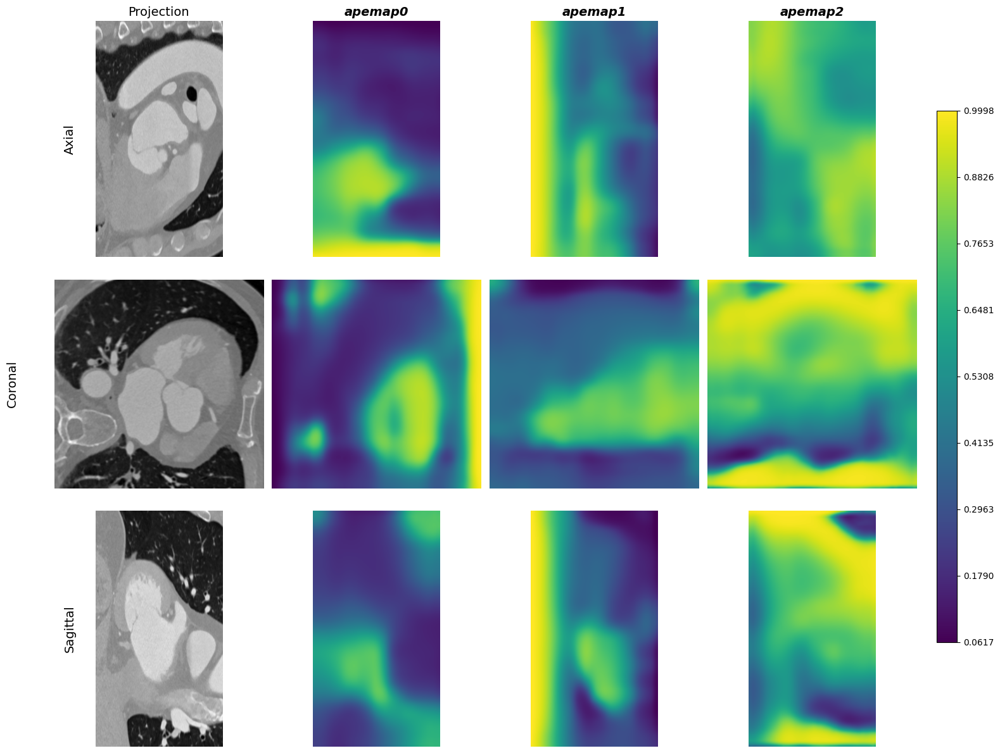

In [80]:
fig = visualize_ape_channels(
    image=original_image,
    ape_maps=ape_maps,
    channel_indices=[0, 1, 2]
)
plt.show()

## Projection of 3D scatter plot of APE embeddings of differenct organs' centers

In [ ]:
# APE model
model = APE(pretrained=True)

# base path
base_path = "data/imageCAS_test/train"
patients = list(range(1, 51))  # 1~50 patients


for patient_id in tqdm(patients, desc="processing patients"):

    patient_folder = os.path.join(base_path, str(patient_id))
    
    if not os.path.exists(patient_folder):
        print(f"patient {patient_id} folder does not exist.")
        continue
    
    image_path = os.path.join(patient_folder, "img.nii.gz")
    
    if not os.path.exists(image_path):
        print(f"patient {patient_id} image file does not exist.")
        continue
    
    try:
        # load image
        print(f"patient {patient_id} image loading...")
        image, nifti_img = load_image(image_path)
        
        # APE map and embedding generation
        print(f"patient {patient_id} embedding generation...")
        ape_maps, embeddings = inference(model, image)
        
        # save result file path
        ape_maps_path = os.path.join(patient_folder, "ape_maps.npy")
        embeddings_path = os.path.join(patient_folder, "embeddings.npy")
        
        # save result file path
        print(f"patient {patient_id} result saving...")
        np.save(ape_maps_path, ape_maps.cpu().numpy())
        np.save(embeddings_path, embeddings.cpu().numpy())
        
        # memory cleanup
        del image, ape_maps, embeddings
        torch.cuda.empty_cache()
        
        print(f"patient {patient_id} processing completed!")
    
    except Exception as e:
        print(f"patient {patient_id} processing error: {str(e)}")

print("all patients processing completed!")

In [82]:
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib
import os

def visualize_embeddings_from_npy(npy_path, image_path=None, output_path=None, channel_indices=[0, 1, 2]):

    # load embeddings
    embeddings = np.load(npy_path)
    
    if embeddings.ndim == 5 and embeddings.shape[0] == 1:
        embeddings = embeddings[0]  # [B, C, H, W, D] -> [C, H, W, D]
    
    num_channels = len(channel_indices)
    channels = [embeddings[i] for i in channel_indices]
    
    # load image
    if image_path and os.path.exists(image_path):
        nifti_img = nib.load(image_path)
        image_data = nifti_img.get_fdata()
        # normalize to 0-1
        image_data = (image_data - image_data.min()) / (image_data.max() - image_data.min() + 1e-8)
    else:
        image_data = None
    
    # calculate middle slice
    _, h, w, d = embeddings.shape
    mid_h, mid_w, mid_d = h//2, w//2, d//2
    
    # normalize each channel
    normalized_channels = []
    for channel in channels:
        min_val = channel.min()
        max_val = channel.max()
        normalized = (channel - min_val) / (max_val - min_val + 1e-8)
        normalized_channels.append(normalized)
    
    fig = plt.figure(figsize=(15, 10))
    
    rows = 3  # Axial, Coronal, Sagittal
    cols = num_channels + 1  # original + channels
    
    row_titles = ['Axial', 'Coronal', 'Sagittal']
    
    cmap = 'viridis'
    
    # calculate vmin, vmax (apply to each channel)
    vmin = 0.0
    vmax = 1.0
    
    gs = plt.GridSpec(rows, cols, figure=fig, width_ratios=[1]*cols, height_ratios=[1]*rows)
    
    plt.subplots_adjust(right=0.92)
    
    col_titles = ['Projection'] + [f'apemap{idx}' for idx in channel_indices]
    for i, title in enumerate(col_titles):
        if i > 0:
            plt.figtext(0.18 + 0.2 * i, 0.95, title, ha='center', fontsize=14, fontweight='bold', style='italic')
        else:
            plt.figtext(0.18 + 0.2 * i, 0.95, title, ha='center', fontsize=14)
    
    # visualize original image and each channel
    for row, view in enumerate(row_titles):
        ax_row = fig.add_subplot(gs[row, 0])
        ax_row.text(-0.15, 0.5, view, rotation=90, verticalalignment='center', fontsize=12)
        ax_row.axis('off')
        
        # select slice
        if view == 'Axial':
            if image_data is not None:
                img_slice = image_data[mid_h, :, :]
            channel_slices = [channel[mid_h, :, :] for channel in normalized_channels]
        elif view == 'Coronal':
            if image_data is not None:
                img_slice = image_data[:, :, mid_d]
            channel_slices = [channel[:, :, mid_d] for channel in normalized_channels]
        else:  # Sagittal
            if image_data is not None:
                img_slice = image_data[:, mid_w, :]
            channel_slices = [channel[:, mid_w, :] for channel in normalized_channels]
        
        # visualize original image
        ax = fig.add_subplot(gs[row, 0])
        if image_data is not None:
            ax.imshow(img_slice, cmap='gray')
        ax.axis('off')
        
        # visualize each channel
        for col, channel_slice in enumerate(channel_slices, 1):
            ax = fig.add_subplot(gs[row, col])
            im = ax.imshow(channel_slice, cmap=cmap, vmin=vmin, vmax=vmax)
            ax.axis('off')
    
    # add colorbar
    cbar_ax = fig.add_axes([0.93, 0.15, 0.01, 0.7])
    cbar = plt.colorbar(im, cax=cbar_ax)
    # show exact values on colorbar
    cbar_ticks = np.linspace(0, 1, 9)
    actual_ticks = np.linspace(vmin, vmax, 9)
    cbar.set_ticks(cbar_ticks)
    cbar.set_ticklabels([f"{tick:.4f}" for tick in actual_ticks])
    
    plt.tight_layout(rect=[0, 0, 0.92, 0.95])
    
    # save result or display
    if output_path:
        plt.savefig(output_path, dpi=300, bbox_inches='tight')
        plt.close()
        print(f"visualization result saved to {output_path}.")
    else:
        plt.show()

/tmp/ipykernel_3050974/2413125023.py:121: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.92, 0.95])


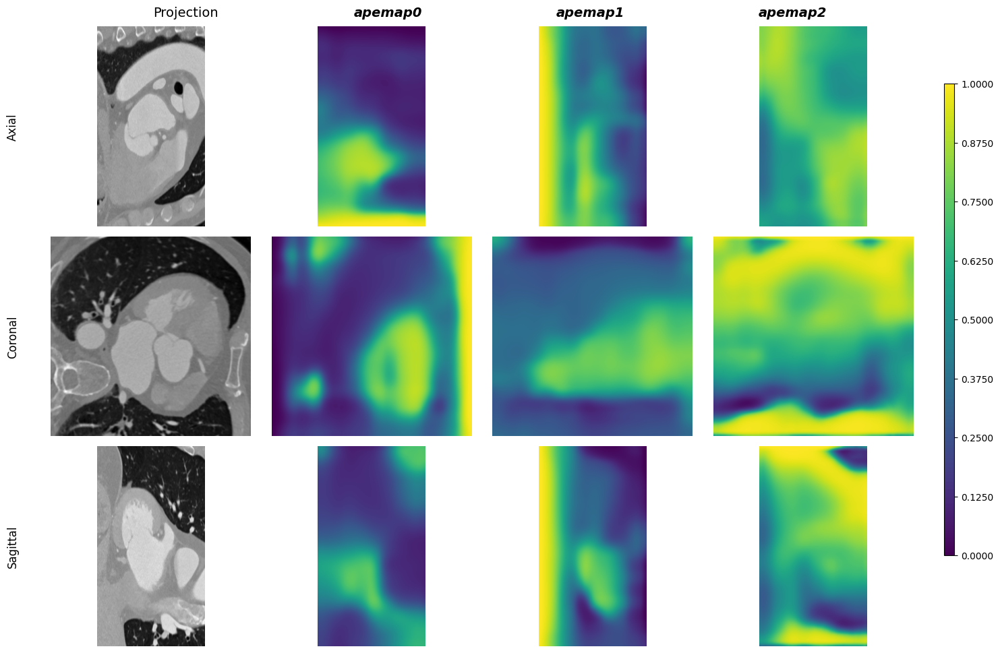

In [83]:
visualize_embeddings_from_npy(
    npy_path="data/imageCAS_test/train/1/ape_maps.npy",
    image_path="data/imageCAS_test/train/1/img.nii.gz",
    channel_indices=[0, 1, 2]
)

## 3D scatter plot of APE embeddings of differenct organs' centers

In [106]:
def extract_organ_center_embeddings(ape_maps_path, seg_path, organ_ids=None):
    """
    extract embedding values at the center of specific organs.
    
    """
    # load embeddings
    embeddings = np.load(ape_maps_path)
    if embeddings.ndim == 5:
        embeddings = embeddings[0]  # remove batch dimension [C, H, W, D]
    
    # load segmentation map
    seg_nii = nib.load(seg_path)
    seg_map = seg_nii.get_fdata().astype(int)
    
    # check size mismatch and adjust
    embed_shape = embeddings.shape[1:]  # [H, W, D]
    seg_shape = seg_map.shape
    
    if embed_shape != seg_shape:
        raise ValueError(f"size mismatch: {embed_shape} != {seg_shape}")
    
    # if organ_ids is not provided, use all unique IDs
    if organ_ids is None:
        organ_ids = np.unique(seg_map)
        # exclude background (0)
        organ_ids = organ_ids[organ_ids > 0]
    
    # calculate organ-specific center embeddings
    organ_embeddings = {}
    for organ_id in organ_ids:
        # create mask for the organ
        mask = (seg_map == organ_id)
        
        # if no voxels in the mask, skip
        if np.sum(mask) == 0:
            raise ValueError(f"no voxels for organ ID {organ_id}. skip.")
        
        # calculate center coordinates of the organ
        indices = np.where(mask)
        center_x = int(np.mean(indices[0]))
        center_y = int(np.mean(indices[1]))
        center_z = int(np.mean(indices[2]))
        
        print(f"organ ID {organ_id} center: ({center_x}, {center_y}, {center_z})")
        
        # extract embedding value at the center
        organ_embedding = []
        for channel in range(embeddings.shape[0]):
            channel_data = embeddings[channel]
            center_value = channel_data[center_x, center_y, center_z]
            organ_embedding.append(center_value)
        
        organ_embeddings[organ_id] = np.array(organ_embedding)
    
    # organ name mapping
    organ_names = {
        1: "coronary artery",
        2: "aorta",
        3: "heart myocardium",
        4: "heart ventricle left",
        5: "heart ventricle right",
        6: "heart atrium left",
        7: "heart atrium right",
    }
    
    return organ_embeddings, organ_names

In [107]:
# 2. 모든 환자의 장기별 임베딩 수집
def collect_all_patient_embeddings(base_path, patient_ids, ape_maps_filename="ape_maps.npy", seg_filename="heart_combined.nii.gz"):
    """
    collect all patient organ embeddings.
    
    """
    all_embeddings = {}
    organ_names = None
    
    for patient_id in tqdm(patient_ids, desc="processing patients"):
        patient_folder = os.path.join(base_path, str(patient_id))
        
        # file path
        ape_maps_path = os.path.join(patient_folder, ape_maps_filename)
        seg_path = os.path.join(patient_folder, seg_filename)
        
        # check file existence
        if not os.path.exists(ape_maps_path) or not os.path.exists(seg_path):
            print(f"patient {patient_id} file does not exist. skip.")
            continue
        
        try:
            # extract organ embeddings
            patient_embeddings, organ_names = extract_organ_center_embeddings(ape_maps_path, seg_path)
            all_embeddings[patient_id] = patient_embeddings
        except Exception as e:
            print(f"patient {patient_id} processing error: {str(e)}")
    
    return all_embeddings, organ_names

In [ ]:
base_path = "data/imageCAS_test/train"
patient_ids = range(1, 51)  # patient 1~50
    
# collect all patient embeddings
all_embeddings, organ_names = collect_all_patient_embeddings(
    base_path=base_path,
    patient_ids=patient_ids,
    ape_maps_filename="ape_maps.npy",
    seg_filename="heart_combined.nii.gz"
)

In [120]:
# 3. 장기별 임베딩을 2D 또는 3D로 시각화
def visualize_organ_embeddings(all_embeddings, organ_names, output_path=None, projection='3d', selected_organs=None):
    """
    visualize all patient organ embeddings.
    
    Args:
        all_embeddings: patient-specific/organ-specific embedding dictionary
        organ_names: organ ID to name dictionary
        output_path: result image save path (None for display)
        projection: '2d' or '3d' visualization selection
        selected_organs: list of organ IDs to visualize (None for all organs)
    """
    # collect all embedding data
    embeddings_data = []
    organ_ids = []
    patient_ids = []
    
    for patient_id, patient_embeddings in all_embeddings.items():
        for organ_id, embedding in patient_embeddings.items():
            # include only selected organs
            if selected_organs is not None and organ_id not in selected_organs:
                continue
                
            embeddings_data.append(embedding)
            organ_ids.append(organ_id)
            patient_ids.append(patient_id)
    
    # if no data, handle
    if len(embeddings_data) == 0:
        print("no data for selected organs.")
        return
    
    embeddings_data = np.array(embeddings_data)
    print("embeddings_data.shape", embeddings_data.shape)
    print(f"선택된 장기 ID: {np.unique(organ_ids)}")
    
    # dimension reduction (t-SNE)
    target_dims = 3 if projection == '3d' else 2
    
    # adjust perplexity (depends on the number of data points)
    perplexity = min(30, max(5, len(embeddings_data) - 1))
    print(f"{len(embeddings_data)}개 임베딩 t-SNE 변환 중... (perplexity={perplexity})")
    
    tsne = TSNE(n_components=target_dims, random_state=42, perplexity=perplexity)
    embeddings_tsne = tsne.fit_transform(embeddings_data)
    
    # specify organ colors (only selected organs)
    unique_organs = np.unique(organ_ids)
    colors = cm.rainbow(np.linspace(0, 1, len(unique_organs)))
    organ_colors = {organ_id: colors[i] for i, organ_id in enumerate(unique_organs)}
    
    # create figure
    fig = plt.figure(figsize=(14, 10))
    
    if projection == '3d': # 3D visualization
        ax = fig.add_subplot(111, projection='3d')
        
        # draw scatter plot for each organ
        for organ_id in unique_organs:
            organ_mask = np.array(organ_ids) == organ_id
            organ_data = embeddings_tsne[organ_mask]
            
            # get organ name
            organ_name = organ_names.get(organ_id, f"ID: {organ_id}")
            
            # draw scatter plot
            ax.scatter(
                organ_data[:, 0], 
                organ_data[:, 1], 
                organ_data[:, 2],
                color=organ_colors[organ_id],
                label=organ_name,
                alpha=0.7,
                s=100,
                edgecolors='w'
            )
            
            # add organ name text
            centroid = np.mean(organ_data, axis=0)
            ax.text(
                centroid[0], centroid[1], centroid[2],
                organ_name,
                bbox=dict(facecolor=organ_colors[organ_id], alpha=0.5),
                fontsize=12
            )
        
        ax.set_xlabel('Dimension 1')
        ax.set_ylabel('Dimension 2')
        ax.set_zlabel('Dimension 3')
        
    else:  # 2D visualization
        ax = fig.add_subplot(111)
        
        # draw scatter plot for each organ
        for organ_id in unique_organs:
            organ_mask = np.array(organ_ids) == organ_id
            organ_data = embeddings_tsne[organ_mask]
            
            # get organ name
            organ_name = organ_names.get(organ_id, f"ID: {organ_id}")
            
            # draw scatter plot
            ax.scatter(
                organ_data[:, 0], 
                organ_data[:, 1],
                color=organ_colors[organ_id],
                label=organ_name,
                alpha=0.7,
                s=100,
                edgecolors='w'
            )
            
            # add organ name text
            centroid = np.mean(organ_data, axis=0)
            ax.text(
                centroid[0], centroid[1],
                organ_name,
                bbox=dict(facecolor=organ_colors[organ_id], alpha=0.5),
                fontsize=12
            )
        
        ax.set_xlabel('Dimension 1')
        ax.set_ylabel('Dimension 2')
    
    # include selected organs in title
    if selected_organs is not None:
        selected_names = [organ_names.get(org_id, f"ID: {org_id}") for org_id in selected_organs]
        ax.set_title(f'APE embeddings of selected organs: {", ".join(selected_names)}', fontsize=16)
    else:
        ax.set_title('Projection of 3D scatter plot of APE embeddings', fontsize=16)
        
    ax.grid(alpha=0.3)
    
    # change background color
    ax.set_facecolor('#eef1f5')
    
    # save result or display
    plt.tight_layout()
    
    if output_path:
        plt.savefig(output_path, dpi=300, bbox_inches='tight')
        plt.close()
        print(f"visualization result saved to {output_path}.")
    else:
        plt.show()

embeddings_data.shape (100, 3)
선택된 장기 ID: [4 5]
100개 임베딩 t-SNE 변환 중... (perplexity=30)


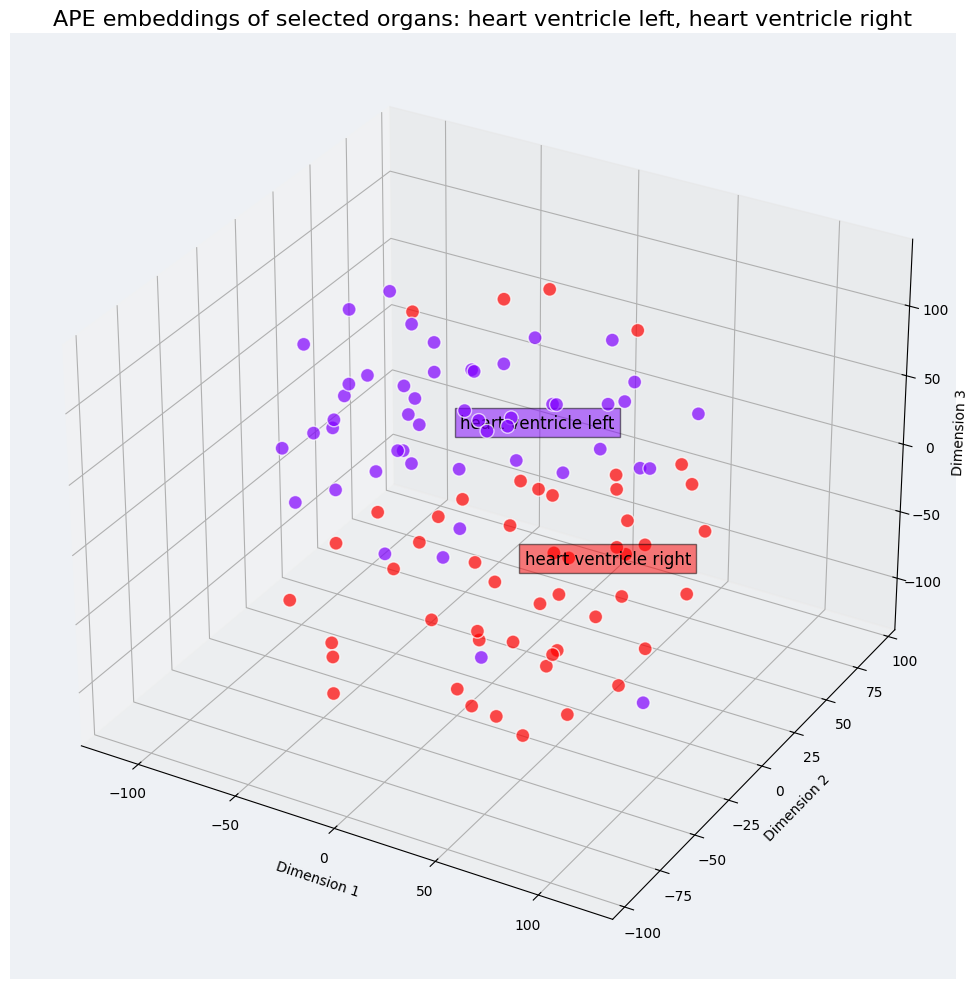

In [137]:
# 장기별 임베딩 시각화 (3D)
selected_organ_ids = [4, 5]
visualize_organ_embeddings(
    all_embeddings=all_embeddings,
    organ_names=organ_names,
    projection='3d',
    selected_organs=selected_organ_ids
)

embeddings_data.shape (100, 3)
선택된 장기 ID: [4 5]
100개 임베딩 t-SNE 변환 중... (perplexity=30)


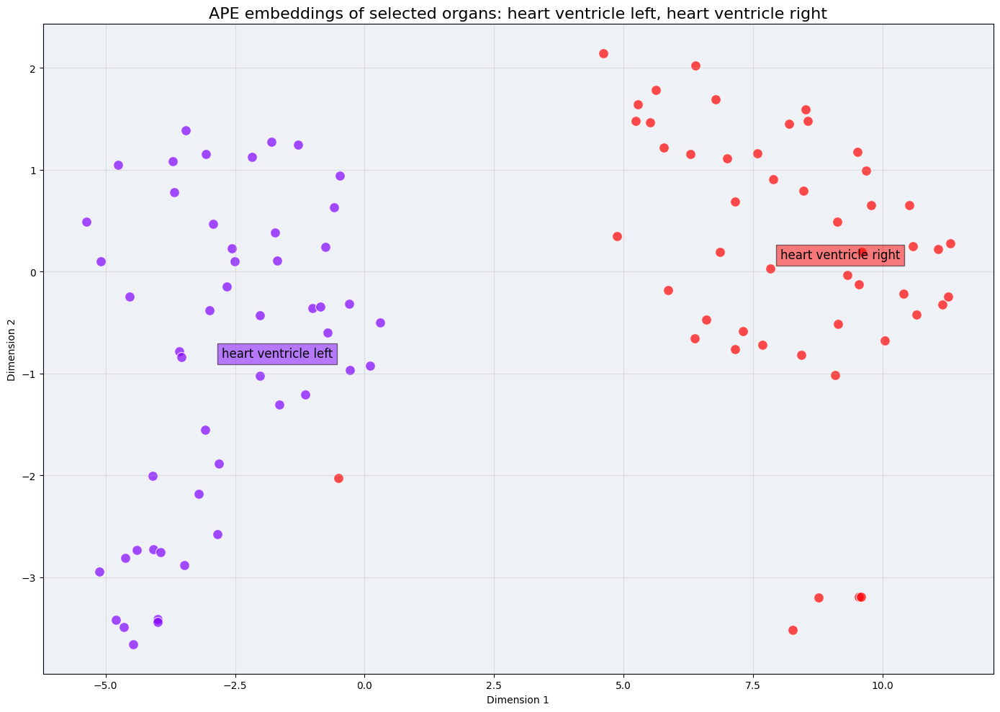

In [138]:
# 장기별 임베딩 시각화 (2D)
visualize_organ_embeddings(
    all_embeddings=all_embeddings,
    organ_names=organ_names,
    projection='2d',
    selected_organs=selected_organ_ids
)

In [126]:
def visualize_ape_3d_direct(all_embeddings, organ_names, output_path=None, selected_organs=None, normalize=True):
    """
    APE 맵의 3개 채널을 직접 3D 좌표로 사용하여 시각화합니다.
    
    Args:
        all_embeddings: 환자별/장기별 임베딩 딕셔너리
        organ_names: 장기 ID에 해당하는 이름 딕셔너리
        output_path: 결과 이미지 저장 경로 (None이면 화면에 표시)
        selected_organs: 시각화할 장기 ID 리스트 (None이면 모든 장기 시각화)
        normalize: 각 축을 0-1 범위로 정규화할지 여부
    """
    # 데이터 수집
    coordinates = []  # (x, y, z) 좌표 저장
    organ_ids = []    # 장기 ID 저장
    patient_ids = []  # 환자 ID 저장
    
    for patient_id, patient_embeddings in all_embeddings.items():
        for organ_id, embedding in patient_embeddings.items():
            # 선택된 장기만 포함
            if selected_organs is not None and organ_id not in selected_organs:
                continue
            
            # APE 맵의 첫 3개 채널만 사용 (x, y, z 좌표로)
            if len(embedding) >= 3:
                coord = embedding[:3]  # 첫 3개 채널값
                coordinates.append(coord)
                organ_ids.append(organ_id)
                patient_ids.append(patient_id)
            else:
                print(f"환자 {patient_id}, 장기 {organ_id}의 임베딩이 3차원 미만입니다. 건너뜁니다.")
    
    # 데이터가 없는 경우 처리
    if len(coordinates) == 0:
        print("시각화할 데이터가 없습니다!")
        return
    
    # NumPy 배열로 변환
    coordinates = np.array(coordinates)
    print(f"좌표 데이터 형태: {coordinates.shape}")
    
    # 정규화 (0-1 범위로)
    if normalize:
        min_vals = coordinates.min(axis=0)
        max_vals = coordinates.max(axis=0)
        # 0으로 나누는 것 방지
        ranges = max_vals - min_vals
        ranges[ranges == 0] = 1  # 0으로 나누는 것 방지
        
        coordinates = (coordinates - min_vals) / ranges
        print("좌표를 0-1 범위로 정규화했습니다.")
    
    # 장기별 색상 지정
    unique_organs = np.unique(organ_ids)
    colors = cm.rainbow(np.linspace(0, 1, len(unique_organs)))
    organ_colors = {organ_id: colors[i] for i, organ_id in enumerate(unique_organs)}
    
    # 3D 그림 생성
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    # 장기별로 산점도 그리기
    for organ_id in unique_organs:
        organ_mask = np.array(organ_ids) == organ_id
        organ_coords = coordinates[organ_mask]
        
        # 장기 이름 가져오기
        organ_name = organ_names.get(organ_id, f"ID: {organ_id}")
        
        # 산점도 그리기
        scatter = ax.scatter(
            organ_coords[:, 0],  # APE 채널 0 → x축
            organ_coords[:, 1],  # APE 채널 1 → y축
            organ_coords[:, 2],  # APE 채널 2 → z축
            color=organ_colors[organ_id],
            label=organ_name,
            alpha=0.7,
            s=100,
            edgecolors='w'
        )
        
        # 장기 이름 텍스트 추가 (중심점에)
        centroid = np.mean(organ_coords, axis=0)
        ax.text(
            centroid[0], centroid[1], centroid[2],
            organ_name,
            bbox=dict(facecolor=organ_colors[organ_id], alpha=0.5),
            fontsize=12
        )
    
    # 축 레이블
    ax.set_xlabel('APE Channel 0', fontsize=12)
    ax.set_ylabel('APE Channel 1', fontsize=12)
    ax.set_zlabel('APE Channel 2', fontsize=12)
    
    # 균일한 축 비율 설정
    max_range = max([
        coordinates[:, 0].max() - coordinates[:, 0].min(),
        coordinates[:, 1].max() - coordinates[:, 1].min(),
        coordinates[:, 2].max() - coordinates[:, 2].min()
    ])
    
    mid_x = (coordinates[:, 0].max() + coordinates[:, 0].min()) / 2
    mid_y = (coordinates[:, 1].max() + coordinates[:, 1].min()) / 2
    mid_z = (coordinates[:, 2].max() + coordinates[:, 2].min()) / 2
    
    ax.set_xlim(mid_x - max_range/2, mid_x + max_range/2)
    ax.set_ylim(mid_y - max_range/2, mid_y + max_range/2)
    ax.set_zlim(mid_z - max_range/2, mid_z + max_range/2)
    
    # 제목 설정
    if selected_organs is not None:
        selected_names = [organ_names.get(org_id, f"ID: {org_id}") for org_id in selected_organs]
        ax.set_title(f'Direct APE coordinates of selected organs: {", ".join(selected_names)}', fontsize=14)
    else:
        ax.set_title('Direct APE coordinates visualization', fontsize=14)
    
    # 배경색 및 그리드 설정
    ax.set_facecolor('#eef1f5')
    ax.grid(alpha=0.3)
    
    # 전설 추가
    ax.legend(loc='upper right', bbox_to_anchor=(1.0, 1.0), fontsize=10)
    
    # 시점 조정 (더 좋은 시각화를 위해)
    ax.view_init(elev=30, azim=45)
    
    # 결과 저장 또는 표시
    plt.tight_layout()
    
    if output_path:
        plt.savefig(output_path, dpi=300, bbox_inches='tight')
        plt.close()
        print(f"시각화 결과가 {output_path}에 저장되었습니다.")
    else:
        plt.show()

좌표 데이터 형태: (100, 3)


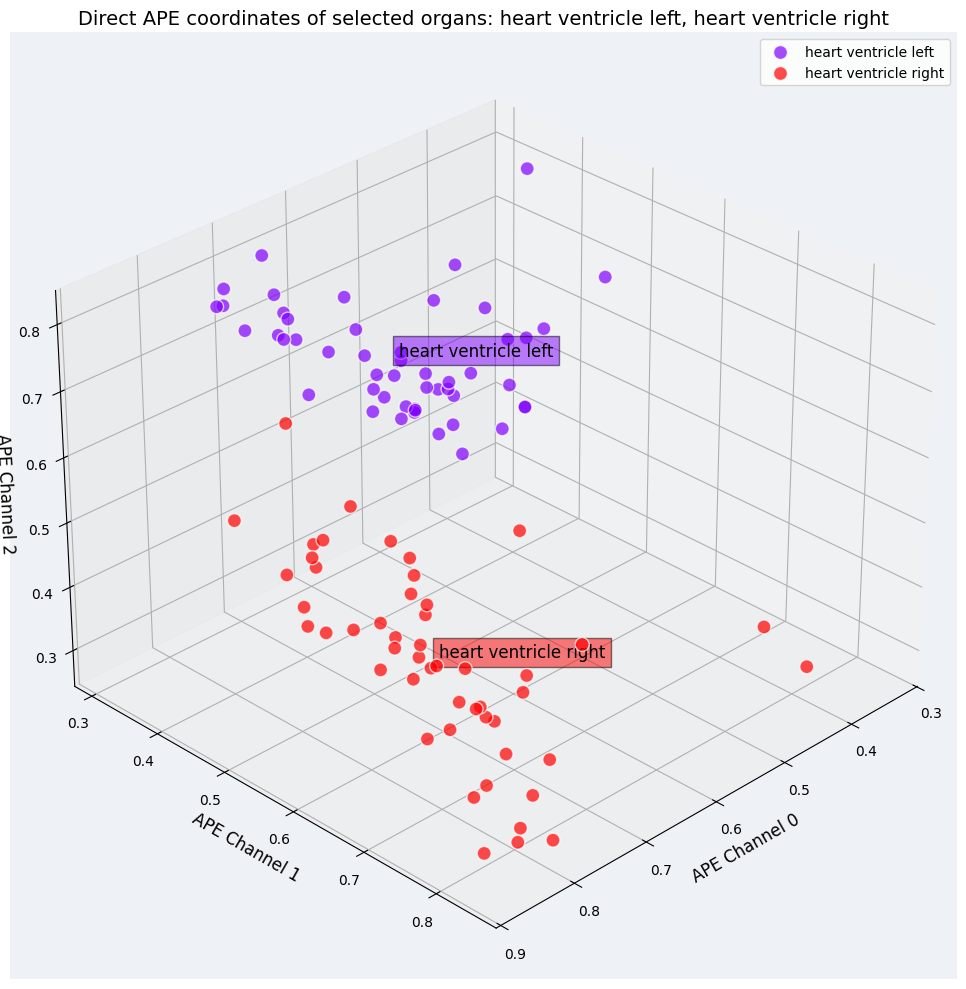

: 

In [ ]:
visualize_ape_3d_direct(
    all_embeddings=all_embeddings,
    organ_names=organ_names,
    selected_organs=[4, 5],  # 선택된 장기만 표시
    normalize=False  # 좌표 정규화
)